# Recommendation Engine EDA & Model

### Importing Necessary Libraries

In [1]:
import pandas as pd
import numpy as np

from sklearn.metrics import pairwise_distances
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

### Import Data

In [2]:
Music_Data=pd.read_csv(r"D:\Project\data.csv")
Music_Data

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.98200,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.6650,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.73200,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.1600,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.96100,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.1010,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.96700,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.3810,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.95700,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.2290,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170648,0.6080,2020,0.08460,"['Anuel AA', 'Daddy Yankee', 'KAROL G', 'Ozuna...",0.786,301714,0.808,0,0KkIkfsLEJbrcIhYsCL7L5,0.000289,7,0.0822,-3.702,1,China,72,2020-05-29,0.0881,105.029
170649,0.7340,2020,0.20600,['Ashnikko'],0.717,150654,0.753,0,0OStKKAuXlxA0fMH54Qs6E,0.000000,7,0.1010,-6.020,1,Halloweenie III: Seven Days,68,2020-10-23,0.0605,137.936
170650,0.6370,2020,0.10100,['MAMAMOO'],0.634,211280,0.858,0,4BZXVFYCb76Q0Klojq4piV,0.000009,4,0.2580,-2.226,0,AYA,76,2020-11-03,0.0809,91.688
170651,0.1950,2020,0.00998,['Eminem'],0.671,337147,0.623,1,5SiZJoLXp3WOl3J4C8IK0d,0.000008,2,0.6430,-7.161,1,Darkness,70,2020-01-17,0.3080,75.055


### Data Understanding

In [3]:
Music_Data=Music_Data.iloc[70653:,]

In [4]:
Music_Data.index

RangeIndex(start=70653, stop=170653, step=1)

In [5]:
Music_Data.index=range(0,100000)

In [6]:
Music_Data=Music_Data.drop(columns=["id","release_date"])

In [7]:
Music_Data

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,name,popularity,speechiness,tempo
0,0.818,1998,0.11200,"['2Pac', 'Snoop Dogg', 'Nate Dogg', 'Dru Down']",0.927,273160,0.746,1,0.000000,2,0.1300,-5.341,1,All About U,43,0.1500,103.008
1,0.821,1998,0.01400,['Catch 22'],0.541,116947,0.961,0,0.002820,2,0.2410,-5.530,1,9mm and a Three Piece Suit,44,0.1010,136.030
2,0.518,1998,0.00129,['Metallica'],0.349,470133,0.943,0,0.454000,4,0.0529,-5.704,1,Am I Evil?,43,0.0922,97.491
3,0.692,1998,0.00519,"['DMX', 'Jadakiss', 'Styles P']",0.572,247893,0.771,1,0.000000,6,0.3360,-10.561,1,We Don't Give A Fuck,44,0.3730,88.893
4,0.644,1998,0.01710,['The Presidents Of The United States Of Ameri...,0.438,153093,0.816,0,0.000000,1,0.3820,-7.573,1,Cleveland Rocks,43,0.0564,148.244
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,0.608,2020,0.08460,"['Anuel AA', 'Daddy Yankee', 'KAROL G', 'Ozuna...",0.786,301714,0.808,0,0.000289,7,0.0822,-3.702,1,China,72,0.0881,105.029
99996,0.734,2020,0.20600,['Ashnikko'],0.717,150654,0.753,0,0.000000,7,0.1010,-6.020,1,Halloweenie III: Seven Days,68,0.0605,137.936
99997,0.637,2020,0.10100,['MAMAMOO'],0.634,211280,0.858,0,0.000009,4,0.2580,-2.226,0,AYA,76,0.0809,91.688
99998,0.195,2020,0.00998,['Eminem'],0.671,337147,0.623,1,0.000008,2,0.6430,-7.161,1,Darkness,70,0.3080,75.055


In [8]:
Music_Data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 17 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           100000 non-null  float64
 1   year              100000 non-null  int64  
 2   acousticness      100000 non-null  float64
 3   artists           100000 non-null  object 
 4   danceability      100000 non-null  float64
 5   duration_ms       100000 non-null  int64  
 6   energy            100000 non-null  float64
 7   explicit          100000 non-null  int64  
 8   instrumentalness  100000 non-null  float64
 9   key               100000 non-null  int64  
 10  liveness          100000 non-null  float64
 11  loudness          100000 non-null  float64
 12  mode              100000 non-null  int64  
 13  name              100000 non-null  object 
 14  popularity        100000 non-null  int64  
 15  speechiness       100000 non-null  float64
 16  tempo             100

In [9]:
Popular_Songs=Music_Data[Music_Data["popularity"]>80]

## Most Popular Songs

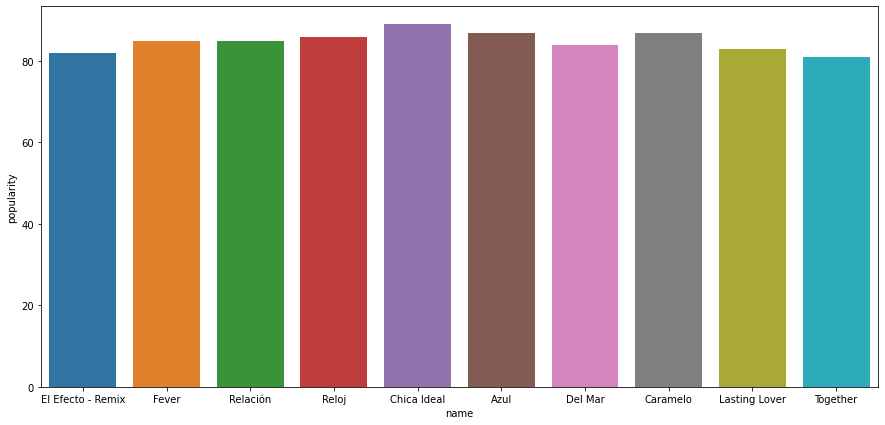

In [10]:
plt.figure(figsize=[15,7])
ax=sns.barplot(x="name",y="popularity",data=Popular_Songs.head(10))
plt.show()

## Frequency of Songs based on popularity

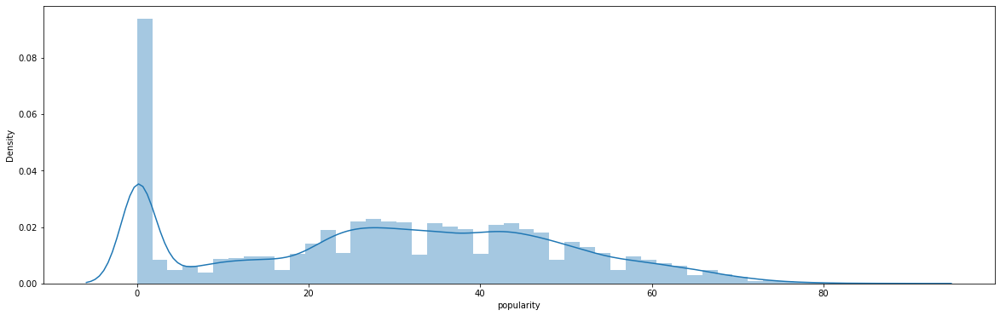

In [11]:
plt.figure(figsize = (20,6))
sns.distplot(Music_Data["popularity"])
plt.show()

## Frequency of songs based on Song duration 

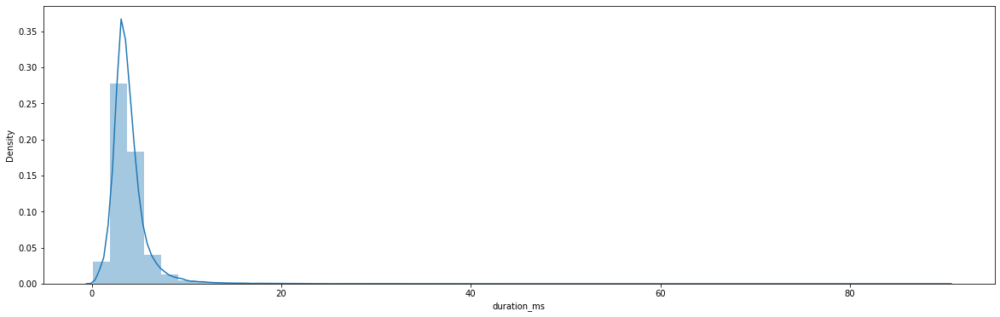

In [12]:
plt.figure(figsize = (20,6))
sns.distplot((Music_Data["duration_ms"]/1000)/60)
plt.show()

In [13]:
((Music_Data["duration_ms"]/1000)/60).mode()

0    4.0
Name: duration_ms, dtype: float64

### Maximul frequesncy of songs with respect to duration falls on 4 minutes

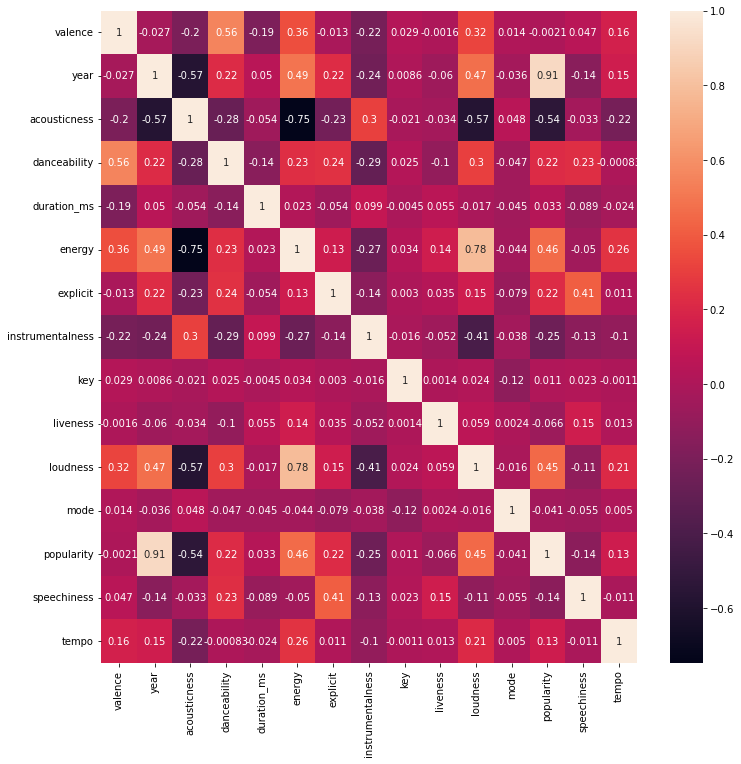

In [14]:
plt.figure(figsize=(12,12))
sns.heatmap(Music_Data.corr(), annot=True)
plt.show()

## Clustering

In [15]:
Cluster_Data_first=Music_Data.copy()

In [16]:
cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=150))])#, n_jobs=-1
X = Music_Data.select_dtypes(np.number)
cluster_pipeline.fit(X)
Cluster_Data_first['cluster_label'] = cluster_pipeline.predict(X)

In [17]:
Cluster_Data_first.head(7)

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,name,popularity,speechiness,tempo,cluster_label
0,0.818,1998,0.11200,"['2Pac', 'Snoop Dogg', 'Nate Dogg', 'Dru Down']",0.927,273160,0.7460,1,0.00000,2,0.1300,-5.341,1,All About U,43,0.1500,103.008,14
1,0.821,1998,0.01400,['Catch 22'],0.541,116947,0.9610,0,0.00282,2,0.2410,-5.530,1,9mm and a Three Piece Suit,44,0.1010,136.030,73
2,0.518,1998,0.00129,['Metallica'],0.349,470133,0.9430,0,0.45400,4,0.0529,-5.704,1,Am I Evil?,43,0.0922,97.491,119
3,0.692,1998,0.00519,"['DMX', 'Jadakiss', 'Styles P']",0.572,247893,0.7710,1,0.00000,6,0.3360,-10.561,1,We Don't Give A Fuck,44,0.3730,88.893,132
4,0.644,1998,0.01710,['The Presidents Of The United States Of Ameri...,0.438,153093,0.8160,0,0.00000,1,0.3820,-7.573,1,Cleveland Rocks,43,0.0564,148.244,49
5,0.275,1998,0.74800,['Sublime'],0.534,180373,0.0945,0,0.00000,7,0.0997,-13.917,1,Marley Medley: Guava Jelly / This Train - Acou...,44,0.0531,77.668,136
6,0.255,1998,0.74000,['Shirley Bassey'],0.480,161933,0.4470,0,0.00437,4,0.0858,-10.962,0,Diamonds Are Forever,55,0.0360,96.771,11


In [18]:
Cluster_Data=Cluster_Data_first.copy()

## Scatter Plot Of clusters

In [19]:
# from sklearn.decomposition import PCA

# import plotly.graph_objects as go
# import plotly.express as px

# pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
# song_embedding = pca_pipeline.fit_transform(X)
# projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
# projection['title'] = Cluster_Data['name']
# projection['cluster'] = Cluster_Data['cluster_label']
# fig = px.scatter(
#     projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
# fig.show()

## 3-D Model with PCA Components

In [20]:
pca = PCA(n_components=3)

In [21]:
ss=StandardScaler()
scaled_df=ss.fit_transform(Music_Data.drop(columns=["name","artists"]))

In [54]:
pd.DataFrame(scaled_df)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,cluster_label
0,1.124953,0.693875,-0.984297,2.221788,0.300248,0.916291,3.254667,-0.530833,-0.905679,-0.439967,1.029147,0.649249,0.684673,0.347094,-0.460651,14
1,1.136236,0.693875,-1.247197,0.052183,-0.899296,1.714576,-0.307251,-0.521810,-0.905679,0.167708,0.996382,0.649249,0.735585,0.031785,0.614011,73
2,-0.003308,0.693875,-1.281294,-1.026999,1.812785,1.647743,-0.307251,0.921916,-0.338673,-0.862054,0.966217,0.649249,0.684673,-0.024842,-0.640195,119
3,0.651084,0.693875,-1.270831,0.226426,0.106226,1.009115,3.254667,-0.530833,0.228333,0.687790,0.124211,0.649249,0.735585,1.782074,-0.920007,132
4,0.470562,0.693875,-1.238881,-0.526753,-0.621734,1.176197,-0.307251,-0.530833,-1.189182,0.939619,0.642209,0.649249,0.684673,-0.255211,1.011501,49
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,0.335170,1.593433,-1.057802,1.429264,0.519512,1.146494,-0.307251,-0.529909,0.511837,-0.701650,1.313283,0.649249,2.161126,-0.051225,-0.394880,0
99996,0.809040,1.593433,-0.732128,1.041433,-0.640463,0.942281,-0.307251,-0.530833,0.511837,-0.598729,0.911436,0.649249,1.957478,-0.228828,0.676039,0
99997,0.444236,1.593433,-1.013807,0.574912,-0.174922,1.332142,-0.307251,-0.530806,-0.338673,0.260775,1.569161,-1.540240,2.364775,-0.097556,-0.829047,19
99998,-1.218069,1.593433,-1.257981,0.782879,0.791598,0.459597,3.254667,-0.530809,-0.905679,2.368476,0.713633,0.649249,2.059302,1.363806,-1.370348,122


In [23]:
PCA_Values=pd.DataFrame(pca.fit_transform(scaled_df))
PCA_Values.columns=["PC1","PC2","PC3"]
PCA_Values

,PC1,PC2,PC3
0,-3.013595,-1.803646,1.323632
1,-2.552101,-0.186062,-1.216661
2,-1.433723,1.953423,-0.078605
3,-2.223381,-1.577717,2.671235
4,-1.957983,0.501787,-0.885593
...,...,...,...
99995,-3.270235,0.686825,-0.069955
99996,-2.989387,0.291922,-0.671133
99997,-3.329911,0.807245,0.399080
99998,-2.772221,-0.017475,3.980228


<function matplotlib.pyplot.show(close=None, block=None)>

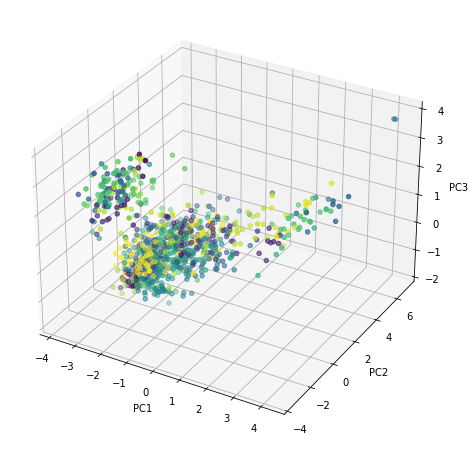

In [24]:
True_Values=Cluster_Data['cluster_label'].head(1000)

x=PCA_Values["PC1"].head(1000)
y=PCA_Values["PC2"].head(1000)
z=PCA_Values["PC3"].head(1000)

plt.figure(figsize=(8,8))
axes = plt.axes(projection='3d')
axes.scatter3D(x,y,z,c=True_Values)
axes.set_xlabel('PC1')
axes.set_ylabel('PC2')
axes.set_zlabel('PC3')
plt.show

## Finding optimum number of clusters

In [25]:
# wcss = []

# for i in range(1,51):
#     kmeans = KMeans(n_clusters=i,random_state=12)
#     kmeans.fit(scaled_df)
#     wcss.append(kmeans.inertia_)

## Elbow Method

In [26]:
# plt.plot(range(1,51),wcss)
# plt.title('ELBOW METHOD')
# plt.ylabel('WCSS')
# plt.show()

### This graph follows hyperbolic curve which means the optimal number of clusters cannot be decided

In [60]:
scaled_df=pd.DataFrame(scaled_df)
scaled_df.index=Cluster_Data_first["name"]
scaled_df

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,cluster_label
name,,,,,,,,,,,,,,,,
All About U,1.124953,0.693875,-0.984297,2.221788,0.300248,0.916291,3.254667,-0.530833,-0.905679,-0.439967,1.029147,0.649249,0.684673,0.347094,-0.460651,14
9mm and a Three Piece Suit,1.136236,0.693875,-1.247197,0.052183,-0.899296,1.714576,-0.307251,-0.521810,-0.905679,0.167708,0.996382,0.649249,0.735585,0.031785,0.614011,73
Am I Evil?,-0.003308,0.693875,-1.281294,-1.026999,1.812785,1.647743,-0.307251,0.921916,-0.338673,-0.862054,0.966217,0.649249,0.684673,-0.024842,-0.640195,119
We Don't Give A Fuck,0.651084,0.693875,-1.270831,0.226426,0.106226,1.009115,3.254667,-0.530833,0.228333,0.687790,0.124211,0.649249,0.735585,1.782074,-0.920007,132
Cleveland Rocks,0.470562,0.693875,-1.238881,-0.526753,-0.621734,1.176197,-0.307251,-0.530833,-1.189182,0.939619,0.642209,0.649249,0.684673,-0.255211,1.011501,49
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
China,0.335170,1.593433,-1.057802,1.429264,0.519512,1.146494,-0.307251,-0.529909,0.511837,-0.701650,1.313283,0.649249,2.161126,-0.051225,-0.394880,0
Halloweenie III: Seven Days,0.809040,1.593433,-0.732128,1.041433,-0.640463,0.942281,-0.307251,-0.530833,0.511837,-0.598729,0.911436,0.649249,1.957478,-0.228828,0.676039,0
AYA,0.444236,1.593433,-1.013807,0.574912,-0.174922,1.332142,-0.307251,-0.530806,-0.338673,0.260775,1.569161,-1.540240,2.364775,-0.097556,-0.829047,19


In [35]:
# from scipy.spatial.distance import pdist, squareform
# distances = squareform(pdist(PCA_Values.values, metric='euclidean'))

In [50]:
# def get_Cluster(song_name):
#     a=pd.DataFrame()
#     if (Cluster_Data_first[Cluster_Data_first["name"]==song_name].index.values) is None:
#         print("Song Not available in the Database")
#     else:
#         b=Cluster_Data_first[Cluster_Data_first["name"]==song_name].index.values
#         cluster_value=int(Cluster_Data_first.iloc[b,17])
#         Cluster_Df= Cluster_Data[Cluster_Data["cluster_label"]==cluster_value]
#         from scipy.spatial.distance import pdist, squareform
#         distances= squareform(pdist(Cluster_Df.values, metric='euclidean'))
#     return pd.DataFrame(distances)

In [67]:
def get_reccomendation(song_name):
    if len(list(Cluster_Data_first[Cluster_Data_first['name']==song_name].index.values))==0:
        print('Sorry!! Song not available')
    else:
        index = int(Cluster_Data_first[Cluster_Data_first['name']==song_name].index.values)
        df = scaled_df[scaled_df['cluster_label']==scaled_df['cluster_label'][index]]
        distances = pd.DataFrame(data=pairwise_distances(X=df ,Y=None,metric='euclidean')).round(2)
        distances.index   = df.index # movie_data['userId'].unique()
        distances.columns = df.index
        #### till here is correct ####
        rec_df = pd.DataFrame(distances[song_name])  #.sort_values(by=distances[name], ascending = True, axis=0)
        rec = rec_df.sort_values(song_name, axis = 0, ascending = True, inplace = False, na_position ='last')
        return pd.DataFrame(rec.iloc[1:12].index.values, columns=['Similar songs'])

In [68]:
get_reccomendation("All About U")

,Similar songs
0,This Is How We Do
1,I Wonder If Heaven Got A Ghetto - Hip-Hop Version
2,She Neva Seen
3,Check Yo Self - Remix
4,We Luv Deez Hoez (feat. Backbone & Big Gipp)
5,I Know What Girls Like
6,Take Your Time
7,Check Yo Self
8,Connected For Life
9,Cum On Everybody


## END